In [ ]:
!pip install lxml openslide-python
!pip install openslide-bin

import os, glob, zipfile
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import xml.etree.ElementTree as ET

from google.colab import drive

import random

import csv
from collections import defaultdict
from sklearn.model_selection import train_test_split  # pratique

import seaborn as sns

from pathlib import Path
import openslide
import pandas as pd

import cv2

from tqdm import tqdm
from openslide import OpenSlide

import math
from PIL import Image, ImageDraw

import shutil

In [ ]:
drive.mount('/content/drive')

ZIP_PATH = "/content/drive/MyDrive/data_CV/MoNuSAC_images_and_annotations.zip"
EXTRACT_DIR = "/content/MoNuSAC_images_and_annotations"

if not os.path.exists(EXTRACT_DIR):
    with zipfile.ZipFile(ZIP_PATH, 'r') as z:
        z.extractall("/content")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


I used the additional information from the challenge to create a CSV file containing information about patients and their associated organs. This will be useful later on for splitting the data. Here, I chose to create a Python dictionary that allows each patient_id to be matched to its organ.

In [ ]:
PATIENT_ORGAN_CSV = "/content/drive/MyDrive/data_CV/patient_organ.csv"
DATA_ROOT = "/content/MoNuSAC_images_and_annotations"  # where we unzipped

# Reading CSV -> dict patient_id -> organ
patient_to_organ = {}
with open(PATIENT_ORGAN_CSV, newline='') as f:
    reader = csv.DictReader(f)
    for row in reader:
        pid = row["patient_id"].strip()
        organ = row["organ"].strip().lower()
        patient_to_organ[pid] = organ

print("Number of patients in the CSV:", len(patient_to_organ))
list(patient_to_organ.items())[:5]

Number of patients in the CSV: 69


[('TCGA-55-1594', 'lung'),
 ('TCGA-69-7760', 'lung'),
 ('TCGA-69-A59K', 'lung'),
 ('TCGA-73-4668', 'lung'),
 ('TCGA-78-7220', 'lung')]

## Retrieve list of ID for each organ

In [ ]:
def extract_patient_id_from_folder(folder_name):
    """
    'TCGA-55-1594-01Z-00-DX1' -> 'TCGA-55-1594'
    """
    parts = folder_name.split('-')
    return "-".join(parts[:3])

In [ ]:
def count_patients_by_organ(data_root, patient_to_organ):
    """
    Displays a table showing the number of patients per organ present in data_root.
    Also returns a dict organ -> list of patient IDs.
    """
    organ_to_patients = defaultdict(set)

    for folder in os.listdir(data_root):
        if not folder.startswith("TCGA-"):
            continue
        pid = extract_patient_id_from_folder(folder)
        organ = patient_to_organ.get(pid, None)
        if organ is None:
            continue
        organ_to_patients[organ].add(pid)

    print("Organ    | # patients")
    print("----------------------")
    for organ, pset in organ_to_patients.items():
        print(f"{organ:<9}| {len(pset)}")

    return organ_to_patients

In [ ]:
def get_patient_ids_by_organ(organ_to_patients):
    """
    Takes the dict organ -> set/list of patients as input,
    and returns 4 lists: ID_lung, ID_kidney, ID_breast, ID_prostate.
    """
    ID_lung     = sorted(list(organ_to_patients.get("lung", [])))
    ID_kidney   = sorted(list(organ_to_patients.get("kidney", [])))
    ID_breast   = sorted(list(organ_to_patients.get("breast", [])))
    ID_prostate = sorted(list(organ_to_patients.get("prostate", [])))
    return ID_lung, ID_kidney, ID_breast, ID_prostate

In [ ]:
organ_to_patients = count_patients_by_organ(DATA_ROOT, patient_to_organ)

Organ    | # patients
----------------------
breast   | 10
kidney   | 12
lung     | 10
prostate | 14


In [ ]:
ID_lung, ID_kidney, ID_breast, ID_prostate = get_patient_ids_by_organ(organ_to_patients)

print("Lung IDs:", ID_lung)
print("Kidney IDs:", ID_kidney)
print("Breast IDs:", ID_breast)
print("Prostate IDs:", ID_prostate)

Lung IDs: ['TCGA-55-1594', 'TCGA-69-7760', 'TCGA-69-A59K', 'TCGA-73-4668', 'TCGA-78-7220', 'TCGA-86-7713', 'TCGA-86-8672', 'TCGA-L4-A4E5', 'TCGA-MP-A4SY', 'TCGA-MP-A4T7']
Kidney IDs: ['TCGA-5P-A9K0', 'TCGA-B9-A44B', 'TCGA-B9-A8YI', 'TCGA-DW-7841', 'TCGA-EV-5903', 'TCGA-F9-A97G', 'TCGA-G7-A8LD', 'TCGA-MH-A560', 'TCGA-P4-AAVK', 'TCGA-SX-A7SR', 'TCGA-UZ-A9PO', 'TCGA-UZ-A9PU']
Breast IDs: ['TCGA-A2-A0CV', 'TCGA-A2-A0ES', 'TCGA-B6-A0WZ', 'TCGA-BH-A18T', 'TCGA-D8-A1X5', 'TCGA-E2-A154', 'TCGA-E9-A22B', 'TCGA-E9-A22G', 'TCGA-EW-A6SD', 'TCGA-S3-AA11']
Prostate IDs: ['TCGA-EJ-5495', 'TCGA-EJ-5505', 'TCGA-EJ-5517', 'TCGA-G9-6342', 'TCGA-G9-6499', 'TCGA-J4-A67Q', 'TCGA-J4-A67T', 'TCGA-KK-A59X', 'TCGA-KK-A6E0', 'TCGA-KK-A7AW', 'TCGA-V1-A8WL', 'TCGA-V1-A9O9', 'TCGA-X4-A8KQ', 'TCGA-YL-A9WY']


Data is well distributed between the differents organ, there isn't an over representation of one organ. This mean that the datset is ballanced.

## Data visualisation

In this part I visualise 3 elements for each kind of organ with their annotations.

In [ ]:
NUCLEI_COLORS = {
    "epithelial": "red",
    "lymphocyte": "green",
    "macrophage": "yellow",
    "neutrophil": "cyan",
    "ambiguous": "white",
}

def extract_patient_id_from_folder(folder_name):
    parts = folder_name.split('-')
    return "-".join(parts[:3])


def parse_monusac_xml(xml_path):
    nuclei = []
    tree = ET.parse(xml_path)
    root = tree.getroot()

    for ann in root.iter('Annotation'):
        # Type of cells in <Attributes><Attribute Name="...">
        cell_type = "ambiguous"  # default
        attrs = ann.find('Attributes')
        if attrs is not None:
            for attr in attrs.iter('Attribute'):
                name = attr.get('Name', '').strip().lower()
                if name in ["epithelial", "lymphocyte", "macrophage", "neutrophil", "ambiguous"]:
                    cell_type = name
                    break

        for region in ann.iter('Region'):
            pts = []
            for vertex in region.iter('Vertex'):
                x = float(vertex.get('X'))
                y = float(vertex.get('Y'))
                pts.append((x, y))
            if pts:
                nuclei.append({'points': pts, 'type': cell_type})
    return nuclei


def find_xml_for_image(img_path):
    folder = os.path.dirname(img_path)
    base = os.path.splitext(os.path.basename(img_path))[0]
    cand = glob.glob(os.path.join(folder, base + ".xml"))
    return cand[0] if cand else None


def show_three_examples_with_xml(
    data_root,
    patient_to_organ,
    organ_name="lung",
    max_nuclei=300
):
    organ_name = organ_name.lower()

    organ_folders = []
    for folder in os.listdir(data_root):
        if not folder.startswith("TCGA-"):
            continue
        pid = extract_patient_id_from_folder(folder)
        organ = patient_to_organ.get(pid, None)
        if organ == organ_name:
            organ_folders.append(os.path.join(data_root, folder))

    organ_tifs = []
    for f in organ_folders:
        organ_tifs.extend(glob.glob(os.path.join(f, "*.tif")))
    organ_tifs = sorted(organ_tifs)

    print(f"Nb .tif {organ_name} trouvés:", len(organ_tifs))
    if len(organ_tifs) == 0:
        return

    if len(organ_tifs) >= 3:
        sample_imgs = random.sample(organ_tifs, 3)
    else:
        sample_imgs = organ_tifs

    n_rows = len(sample_imgs)
    fig, axes = plt.subplots(n_rows, 1, figsize=(8, 6*n_rows))
    if n_rows == 1:
        axes = [axes]

    for ax, img_path in zip(axes, sample_imgs):
        xml_path = find_xml_for_image(img_path)
        img = Image.open(img_path)
        img_arr = np.array(img)

        ax.imshow(img_arr)

        if xml_path is not None:
            nuclei = parse_monusac_xml(xml_path)
            if max_nuclei is not None:
                nuclei = nuclei[:max_nuclei]
            for nuc in nuclei:
                pts = np.array(nuc['points'])
                cell_type = nuc.get('type', 'ambiguous')
                color = NUCLEI_COLORS.get(cell_type, "white")
                ax.plot(pts[:, 0], pts[:, 1], color=color, linewidth=0.7)

            subtitle = f"{os.path.basename(img_path)}\nXML: {os.path.basename(xml_path)}"
        else:
            subtitle = f"{os.path.basename(img_path)}\nXML: non trouvé"

        ax.set_title(subtitle, fontsize=10)
        ax.axis('off')

    legend_elements = [
        Line2D([0], [0], color=NUCLEI_COLORS["epithelial"],  lw=2, label="Epithelial"),
        Line2D([0], [0], color=NUCLEI_COLORS["lymphocyte"], lw=2, label="Lymphocyte"),
        Line2D([0], [0], color=NUCLEI_COLORS["macrophage"], lw=2, label="Macrophage"),
        Line2D([0], [0], color=NUCLEI_COLORS["neutrophil"], lw=2, label="Neutrophil"),
        Line2D([0], [0], color=NUCLEI_COLORS["ambiguous"],  lw=2, label="Ambiguous"),
    ]
    fig.legend(
        handles=legend_elements,
        loc="upper right",
        title="Nuclei types",
        fontsize=10
    )

    plt.tight_layout()
    plt.show()

Nb .tif lung trouvés: 39


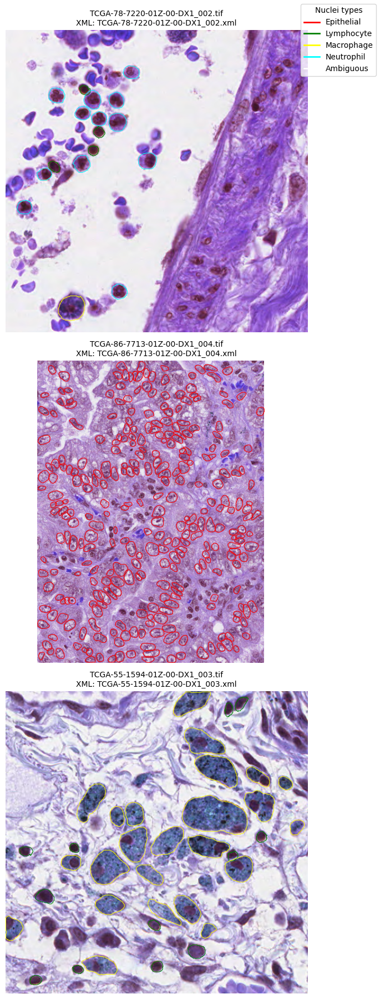

In [ ]:
show_three_examples_with_xml(DATA_ROOT, patient_to_organ, organ_name="lung")

Nb .tif kidney trouvés: 55


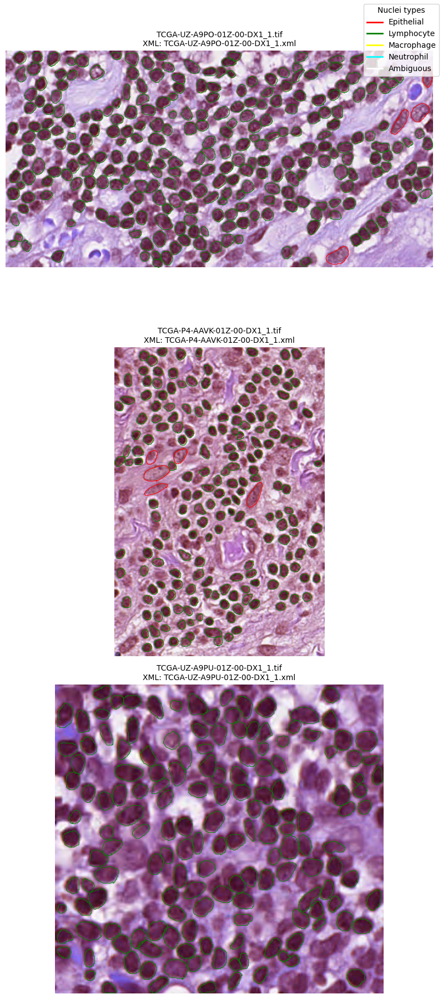

In [ ]:
show_three_examples_with_xml(DATA_ROOT, patient_to_organ, organ_name="kidney")

Nb .tif breast trouvés: 58


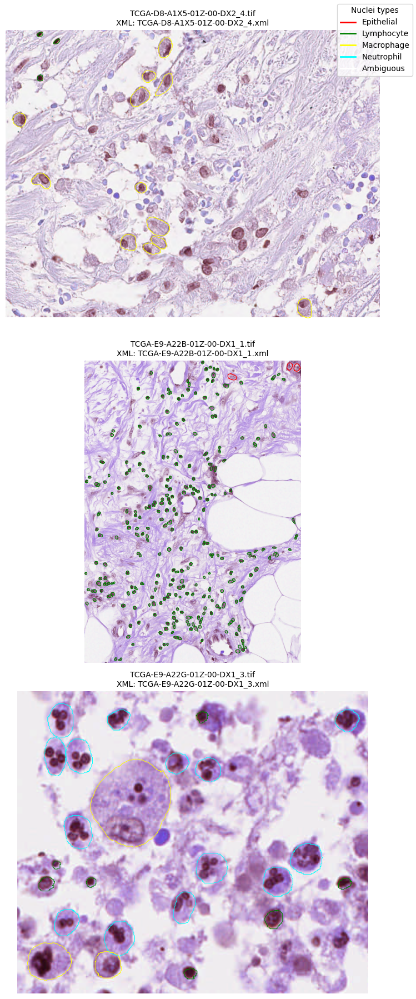

In [ ]:
show_three_examples_with_xml(DATA_ROOT, patient_to_organ, organ_name="breast")

Nb .tif prostate trouvés: 57


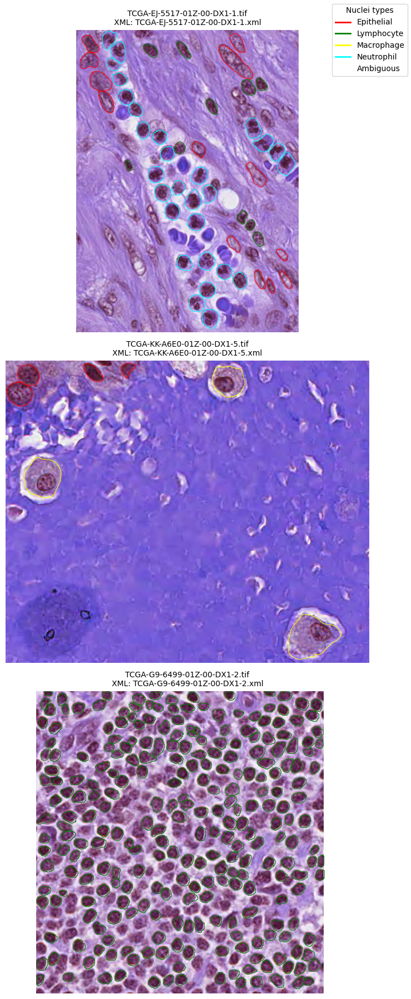

In [ ]:
show_three_examples_with_xml(DATA_ROOT, patient_to_organ, organ_name="prostate")

We can already see that the data need to be pre-processed (noisy, different data size).

## 1- Different pixel size and pixel spacing



We will first check the size of the pixels and the spacing of the pixels in the whole dataset.

In [ ]:
def extract_patient_id_from_folder(folder_name: str) -> str:
    return "-".join(folder_name.split('-')[:3])

def iter_images(data_root: Path, patient_to_organ: dict):
    for folder in data_root.iterdir():
        if not folder.is_dir() or not folder.name.startswith("TCGA-"):
            continue
        pid = extract_patient_id_from_folder(folder.name)
        organ = patient_to_organ.get(pid)
        if organ is None:
            continue
        for ext in ("*.tif", "*.svs"):
            for p in folder.glob(ext):
                yield {
                    "path": str(p),
                    "patient_id": pid,
                    "organ": organ,
                    "ext": p.suffix.lstrip('.').lower(),
                }

def build_image_table(data_root: Path, patient_to_organ: dict) -> pd.DataFrame:
    df = pd.DataFrame(iter_images(data_root, patient_to_organ))
    print("Total number of indexed images:", len(df))
    return df

In [ ]:
def tif_spacing_and_size(path: str):
    with Image.open(path) as im:
        width, height = im.size
        spacing_x_um = spacing_y_um = None
        try:
            tags = im.tag_v2
            x_res = tags.get(282)
            y_res = tags.get(283)
            res_unit = tags.get(296)

            if x_res and y_res and res_unit:
                to_float = lambda r: float(r[0]) / float(r[1]) if isinstance(r, (tuple, list)) else float(r)
                x_res, y_res = to_float(x_res), to_float(y_res)
                if res_unit == 2:      # inch
                    spacing_x_um = 25400.0 / x_res
                    spacing_y_um = 25400.0 / y_res
                elif res_unit == 3:    # cm
                    spacing_x_um = 10000.0 / x_res
                    spacing_y_um = 10000.0 / y_res
        except Exception:
            pass
    return spacing_x_um, spacing_y_um, width, height

def svs_spacing_and_size(path: str):
    slide = openslide.OpenSlide(path)
    width, height = slide.dimensions
    props = slide.properties
    mpp_x = props.get("aperio.MPP") or props.get("openslide.mpp-x")
    mpp_y = props.get("openslide.mpp-y")
    spacing_x_um = float(mpp_x) if mpp_x else None
    spacing_y_um = float(mpp_y) if mpp_y else None
    slide.close()
    return spacing_x_um, spacing_y_um, width, height

def add_spacing_and_size(df: pd.DataFrame, max_samples: int | None = None) -> pd.DataFrame:
    if max_samples is not None and len(df) > max_samples:
        df = df.sample(max_samples, random_state=42).copy()
    else:
        df = df.copy()

    def compute(row):
        try:
            if row["ext"] == "tif":
                return tif_spacing_and_size(row["path"])
            if row["ext"] == "svs":
                return svs_spacing_and_size(row["path"])
        except Exception:
            return None, None, None, None
        return None, None, None, None

    df[["spacing_x_um", "spacing_y_um", "width", "height"]] = \
        df.apply(lambda r: pd.Series(compute(r)), axis=1)
    return df

In [ ]:
DATA_ROOT = Path("/content/MoNuSAC_images_and_annotations")
df_images = build_image_table(DATA_ROOT, patient_to_organ)

Total number of indexed images: 418


In [ ]:
df_info = add_spacing_and_size(df_images)

Some spacing information are abscent, we propagate the information from the svs to complete tifs spacing:

In [ ]:
def propagate_svs_spacing_to_tifs(df: pd.DataFrame) -> pd.DataFrame:
    df = df.copy()
    df["folder"] = df["path"].map(lambda p: str(Path(p).parent))
    svs_spacing = (
        df.query("ext == 'svs' and spacing_x_um.notna() and spacing_y_um.notna()")
          .groupby("folder")[["spacing_x_um", "spacing_y_um"]]
          .first()
          .rename(columns={
              "spacing_x_um": "svs_spacing_x_um",
              "spacing_y_um": "svs_spacing_y_um"
          })
    )

    df = df.merge(svs_spacing, on="folder", how="left")

    mask = (df["ext"] == "tif") & df["spacing_x_um"].isna() & df["svs_spacing_x_um"].notna()
    df.loc[mask, "spacing_x_um"] = df.loc[mask, "svs_spacing_x_um"]
    df.loc[mask, "spacing_y_um"] = df.loc[mask, "svs_spacing_y_um"]

    return df.drop(columns=["folder", "svs_spacing_x_um", "svs_spacing_y_um"])

In [ ]:
df_info = propagate_svs_spacing_to_tifs(df_info)
display(df_info.head(10))

print("Nb NaN (spacing_x):", df_info["spacing_x_um"].isna().sum())

,path,patient_id,organ,ext,spacing_x_um,spacing_y_um,width,height
0,/content/MoNuSAC_images_and_annotations/TCGA-D...,TCGA-D8-A1X5,breast,tif,0.2527,0.2527,1056.0,811.0
1,/content/MoNuSAC_images_and_annotations/TCGA-D...,TCGA-D8-A1X5,breast,tif,0.2527,0.2527,1236.0,1104.0
2,/content/MoNuSAC_images_and_annotations/TCGA-D...,TCGA-D8-A1X5,breast,tif,0.2527,0.2527,1796.0,1254.0
3,/content/MoNuSAC_images_and_annotations/TCGA-D...,TCGA-D8-A1X5,breast,tif,0.2527,0.2527,382.0,205.0
4,/content/MoNuSAC_images_and_annotations/TCGA-D...,TCGA-D8-A1X5,breast,svs,0.2527,0.2527,382.0,205.0
5,/content/MoNuSAC_images_and_annotations/TCGA-D...,TCGA-D8-A1X5,breast,svs,0.2527,0.2527,1236.0,1104.0
6,/content/MoNuSAC_images_and_annotations/TCGA-D...,TCGA-D8-A1X5,breast,svs,0.2527,0.2527,1796.0,1254.0
7,/content/MoNuSAC_images_and_annotations/TCGA-D...,TCGA-D8-A1X5,breast,svs,0.2527,0.2527,1056.0,811.0
8,/content/MoNuSAC_images_and_annotations/TCGA-P...,TCGA-P4-AAVK,kidney,tif,0.2526,0.2526,74.0,173.0
9,/content/MoNuSAC_images_and_annotations/TCGA-P...,TCGA-P4-AAVK,kidney,tif,0.2526,0.2526,412.0,606.0


Nb NaN (spacing_x): 0


In [ ]:
print("Unique Spacings X (µm/pixel):")
print(sorted({round(s, 3) for s in df_info["spacing_x_um"].dropna()}))

print("Unique Spacings Y (µm/pixel):")
print(sorted({round(s, 3) for s in df_info["spacing_y_um"].dropna()}))

print("Width min/max:", df_info["width"].min(), df_info["width"].max())
print("Height min/max:", df_info["height"].min(), df_info["height"].max())

# distribution per organ
print(df_info.groupby("organ")[["width", "height"]].describe())


Unique Spacings X (µm/pixel):
[0.194, 0.246, 0.247, 0.248, 0.251, 0.252, 0.253]
Unique Spacings Y (µm/pixel):
[0.194, 0.246, 0.247, 0.248, 0.251, 0.252, 0.253]
Width min/max: 74.0 2162.0
Height min/max: 81.0 1956.0
          width                                                               \
          count        mean         std    min    25%    50%     75%     max   
organ                                                                          
breast    116.0  663.810345  406.299716   98.0  306.0  605.0  881.00  1796.0   
kidney    110.0  577.872727  449.656589   74.0  255.5  419.0  822.00  1878.0   
lung       78.0  724.102564  410.647306  177.0  512.0  570.0  921.25  2162.0   
prostate  114.0  575.350877  357.531829   90.0  326.0  491.0  734.00  1772.0   

         height                                                               
          count        mean         std    min     25%    50%    75%     max  
organ                                                             

## 2- Contrast and intensity of differences

In [ ]:
def compute_intensity_stats_wsi(
    df: pd.DataFrame,
    img_col: str = "path",
    level: int = 0,
    thumbnail_max: int | None = 1024,
) -> pd.DataFrame:
    def stats_for_row(row):
        path = row[img_col]

        # SVS via OpenSlide
        if str(path).lower().endswith(".svs"):
            slide = OpenSlide(path)
            if thumbnail_max is not None:
                img = slide.get_thumbnail((thumbnail_max, thumbnail_max)).convert("L")
            else:
                img = slide.read_region(
                    (0, 0), level, slide.level_dimensions[level]
                ).convert("L")
            slide.close()
        # TIFF via PIL
        else:
            img = Image.open(path).convert("L")

        arr = np.array(img, dtype=np.float32)
        vals = arr.ravel()
        return pd.Series({
            "mean": vals.mean(),
            "std":  vals.std(),
            "min":  vals.min(),
            "max":  vals.max(),
            "p1":   np.percentile(vals, 1),
            "p99":  np.percentile(vals, 99),
        })

    tqdm.pandas(desc="Intensity stats (WSI + TIFF)")
    stats = df.progress_apply(stats_for_row, axis=1)

    meta_cols = [c for c in ("path", "organ", "patient_id") if c in df.columns]
    return pd.concat([df[meta_cols].reset_index(drop=True), stats], axis=1)

def plot_intensity_distributions(df_intensity: pd.DataFrame):
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    sns.histplot(data=df_intensity, x="mean", hue="organ",
                 bins=30, element="step", stat="count", kde=True)
    plt.title("Distribution of Mean Intensities (Grayscale) by Organ")
    plt.xlabel("Mean (0-255)")

    plt.subplot(1, 2, 2)
    sns.histplot(data=df_intensity, x="std", hue="organ",
                 bins=30, element="step", stat="count", kde=True)
    plt.title("Distribution of Standard Deviations (Contrast) by Organ")
    plt.xlabel("Std Dev")

    plt.tight_layout()
    plt.show()


def plot_intensity_boxplots(df_intensity: pd.DataFrame):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 3, 1)
    sns.boxplot(data=df_intensity, x="organ", y="mean")
    plt.title("Mean Intensity by Organ")
    plt.xticks(rotation=45)

    plt.subplot(1, 3, 2)
    sns.boxplot(data=df_intensity, x="organ", y="std")
    plt.title("Standard Deviation (Contrast) by Organ")
    plt.xticks(rotation=45)

    plt.subplot(1, 3, 3)
    sns.boxplot(data=df_intensity, x="organ", y="p99")
    plt.title("99th Percentile (High Intensities) by Organ")
    plt.xticks(rotation=45)

    plt.tight_layout()
    plt.show()

In [ ]:
df_intensity = compute_intensity_stats_wsi(df_images, img_col="path", thumbnail_max=1024)
df_intensity.head()

Intensity stats (WSI + TIFF): 100%|██████████| 418/418 [00:42<00:00,  9.84it/s]


,path,organ,patient_id,mean,std,min,max,p1,p99
0,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5,211.873657,30.422514,21.0,255.0,112.0,249.0
1,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5,193.183640,49.935604,4.0,255.0,47.0,248.0
2,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5,169.042648,41.666119,15.0,255.0,58.0,244.0
3,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5,188.774734,55.337734,22.0,255.0,55.0,249.0
4,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5,192.746948,51.798233,18.0,255.0,49.0,249.0


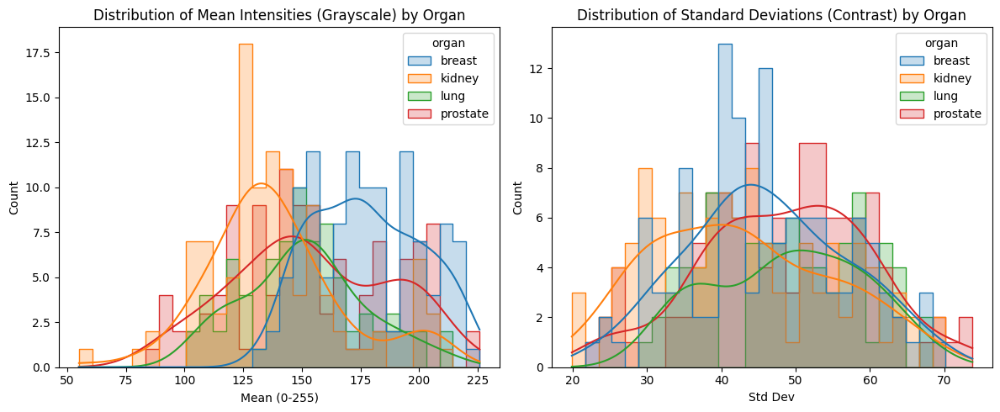

In [ ]:
plot_intensity_distributions(df_intensity)

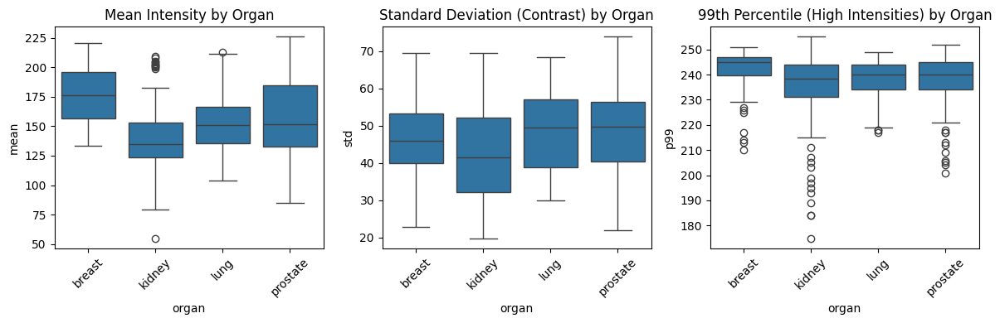

In [ ]:
plot_intensity_boxplots(df_intensity)

## 3- Color variability (HSE)

In [ ]:
df_tif = df_images[df_images["ext"] == "tif"].copy()

In [ ]:
def compute_color_stats_rgb(df: pd.DataFrame,
                            img_col: str = "path",
                            level: int = 0,
                            thumbnail_max: int | None = 1024) -> pd.DataFrame:
    """
    Calculates the mean and standard deviation for R, G, and B channels for each image.
    - .svs files: Read using OpenSlide (thumbnail or specific level).
    - Others (e.g., .tif): Read using PIL.
    """

    def stats_for_row(row):
        path = str(row[img_col])
        if path.lower().endswith(".svs"):
            slide = OpenSlide(path)
            if thumbnail_max is not None:
                img = slide.get_thumbnail((thumbnail_max, thumbnail_max)).convert("RGB")
            else:
                img = slide.read_region(
                    (0, 0), level, slide.level_dimensions[level]
                ).convert("RGB")
            slide.close()
        else:
            img = Image.open(path).convert("RGB")

        arr = np.asarray(img, dtype=np.float32)   # Shape: H, W, 3
        flat = arr.reshape(-1, 3)
        means = flat.mean(axis=0)
        stds  = flat.std(axis=0)

        return pd.Series({
            "mean_R": means[0],
            "mean_G": means[1],
            "mean_B": means[2],
            "std_R": stds[0],
            "std_G": stds[1],
            "std_B": stds[2],
        })

    # Initialize tqdm for pandas to show progress
    tqdm.pandas(desc="Computing RGB color stats (WSI + TIFF)")
    stats = df.progress_apply(stats_for_row, axis=1)

    # Keep relevant metadata if present in the original DataFrame
    meta_cols = [c for c in ("path", "organ", "patient_id") if c in df.columns]
    return pd.concat([df[meta_cols].reset_index(drop=True), stats], axis=1)

In [ ]:
df_color = compute_color_stats_rgb(df_images, img_col="path", thumbnail_max=1024)
df_color.head()

Computing RGB color stats (WSI + TIFF): 100%|██████████| 418/418 [00:51<00:00,  8.07it/s]


,path,organ,patient_id,mean_R,mean_G,mean_B,std_R,std_G,std_B
0,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5,218.190231,206.626892,221.251648,26.569613,33.583691,27.304380
1,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5,204.959427,186.423294,198.168991,41.402714,54.451031,51.117584
2,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5,188.317627,156.445175,182.952560,34.618576,45.668011,41.821770
3,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5,195.605560,179.804794,217.058868,51.595428,62.336597,36.705421
4,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5,217.058868,179.804794,195.605560,36.705421,62.336597,51.595428


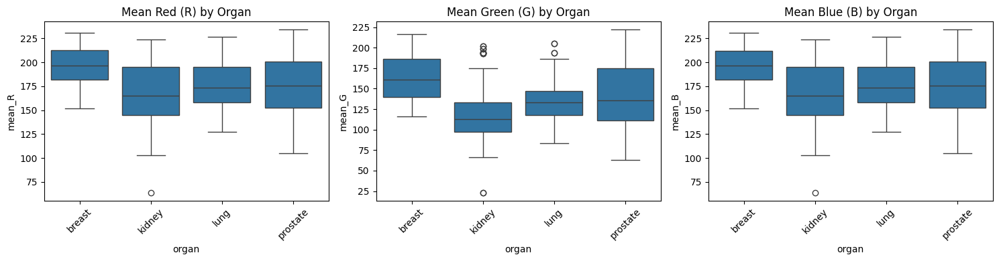

In [ ]:
# Mean per channel
plt.figure(figsize=(15, 4))

plt.subplot(1, 3, 1)
sns.boxplot(data=df_color, x="organ", y="mean_R")
plt.title("Mean Red (R) by Organ")
plt.xticks(rotation=45)

plt.subplot(1, 3, 2)
sns.boxplot(data=df_color, x="organ", y="mean_G")
plt.title("Mean Green (G) by Organ")
plt.xticks(rotation=45)

plt.subplot(1, 3, 3)
sns.boxplot(data=df_color, x="organ", y="mean_B")
plt.title("Mean Blue (B) by Organ")
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

Overlaid histograms (to see color shifts):

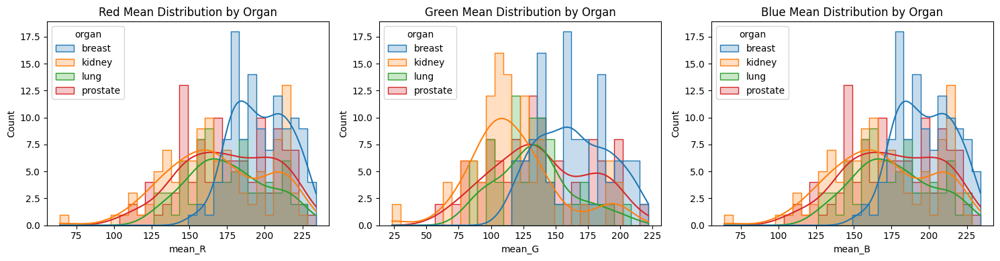

In [ ]:
plt.figure(figsize=(15, 4))

plt.subplot(1, 3, 1)
sns.histplot(data=df_color, x="mean_R", hue="organ", element="step", kde=True, bins=30)
plt.title("Red Mean Distribution by Organ")

plt.subplot(1, 3, 2)
sns.histplot(data=df_color, x="mean_G", hue="organ", element="step", kde=True, bins=30)
plt.title("Green Mean Distribution by Organ")

plt.subplot(1, 3, 3)
sns.histplot(data=df_color, x="mean_B", hue="organ", element="step", kde=True, bins=30)
plt.title("Blue Mean Distribution by Organ")

plt.tight_layout()
plt.show()

We then look at the variability per patient to identify abnormal cases:

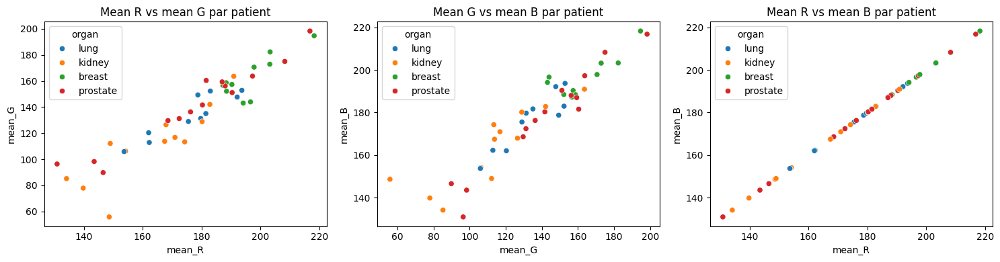

In [ ]:
df_color_patient = (
    df_color
    .groupby(["patient_id", "organ"])[["mean_R", "mean_G", "mean_B"]]
    .mean()
    .reset_index()
)

plt.figure(figsize=(15, 4))

plt.subplot(1, 3, 1)
sns.scatterplot(data=df_color_patient, x="mean_R", y="mean_G", hue="organ")
plt.title("Mean R vs mean G par patient")
plt.xlabel("mean_R")
plt.ylabel("mean_G")

plt.subplot(1, 3, 2)
sns.scatterplot(data=df_color_patient, x="mean_G", y="mean_B", hue="organ")
plt.title("Mean G vs mean B par patient")
plt.xlabel("mean_G")
plt.ylabel("mean_B")

plt.subplot(1, 3, 3)
sns.scatterplot(data=df_color_patient, x="mean_R", y="mean_B", hue="organ")
plt.title("Mean R vs mean B par patient")
plt.xlabel("mean_R")
plt.ylabel("mean_B")

plt.tight_layout()
plt.show()

The distribution is fairly linear. For now, I have chosen to keep all points, but two outliers at the top right could be suppressed with more selective data processing.

## 4- Noise and artifacts

Quantitative indicators of noise/artifacts

Laplacian variance (blur)

In [ ]:
def laplacian_variance(gray_arr):
    lap = cv2.Laplacian(gray_arr, ddepth=cv2.CV_64F)
    return lap.var()

Saturated pixels (0–5 and 250–255)

In [ ]:
def saturation_stats(gray_arr, low_thresh=5, high_thresh=250):
    total = gray_arr.size
    low = (gray_arr < low_thresh).sum() / total
    high = (gray_arr > high_thresh).sum() / total
    return low, high

In [ ]:
# work on the tif
df_tif = df_images[df_images["ext"] == "tif"].copy()

records = []

for _, row in tqdm(df_tif.iterrows(), total=len(df_tif)):
    path = row["path"]
    organ = row.get("organ")
    patient_id = row.get("patient_id")

    img = Image.open(path).convert("RGB")
    gray = np.array(img.convert("L"))

    lap_var = laplacian_variance(gray)
    low_frac, high_frac = saturation_stats(gray)

    records.append({
        "path": path,
        "organ": organ,
        "patient_id": patient_id,
        "lap_var": lap_var,
        "sat_low_frac": low_frac,
        "sat_high_frac": high_frac,
    })

df_quality = pd.DataFrame(records)
df_quality.head()


100%|██████████| 209/209 [00:07<00:00, 26.65it/s]


,path,organ,patient_id,lap_var,sat_low_frac,sat_high_frac
0,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5,285.364677,0.000000e+00,0.006175
1,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5,333.531701,7.328456e-07,0.004657
2,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5,329.792225,0.000000e+00,0.001169
3,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5,187.945407,0.000000e+00,0.005670
4,/content/MoNuSAC_images_and_annotations/TCGA-P...,kidney,TCGA-P4-AAVK,291.091851,0.000000e+00,0.003828


In [ ]:
def show_worst_patches(df_quality,
                       metric,
                       n_patches=20,
                       ascending=True,
                       n_cols=5,
                       path_col="path"):
    """
    Displays the patches with the lowest/highest quality scores based on a specific metric.

    df_quality : DataFrame containing at least [path_col, organ, patient_id, metric]
    metric     : Name of the column to use (e.g., 'lap_var', 'sat_high_frac')
    ascending  : True -> smallest values (e.g., for blurriness detection)
                 False -> largest values (e.g., for over-saturation detection)
    n_patches  : Number of patches to display
    n_cols     : Number of columns in the grid
    path_col   : Column containing the image path (default is 'path')
    """
    df_sorted = df_quality.sort_values(metric, ascending=ascending).head(n_patches)

    n_imgs = len(df_sorted)
    if n_imgs == 0:
        print("No images to display.")
        return

    n_cols = min(n_cols, n_imgs)
    n_rows = int(np.ceil(n_imgs / n_cols))

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(4 * n_cols, 4 * n_rows))
    axes = np.array(axes).reshape(n_rows, n_cols)

    for ax in axes.flatten():
        ax.axis("off")

    # Iterate through sorted patches and plot
    for ax, (_, row) in zip(axes.flatten(), df_sorted.iterrows()):
        img = Image.open(row[path_col]).convert("RGB")
        ax.imshow(img)
        title = f"{row.get('organ', '')} | {row.get('patient_id', '')}\n{metric}={row[metric]:.3f}"
        ax.set_title(title, fontsize=8)
        ax.axis("off")

    plt.tight_layout()
    plt.show()

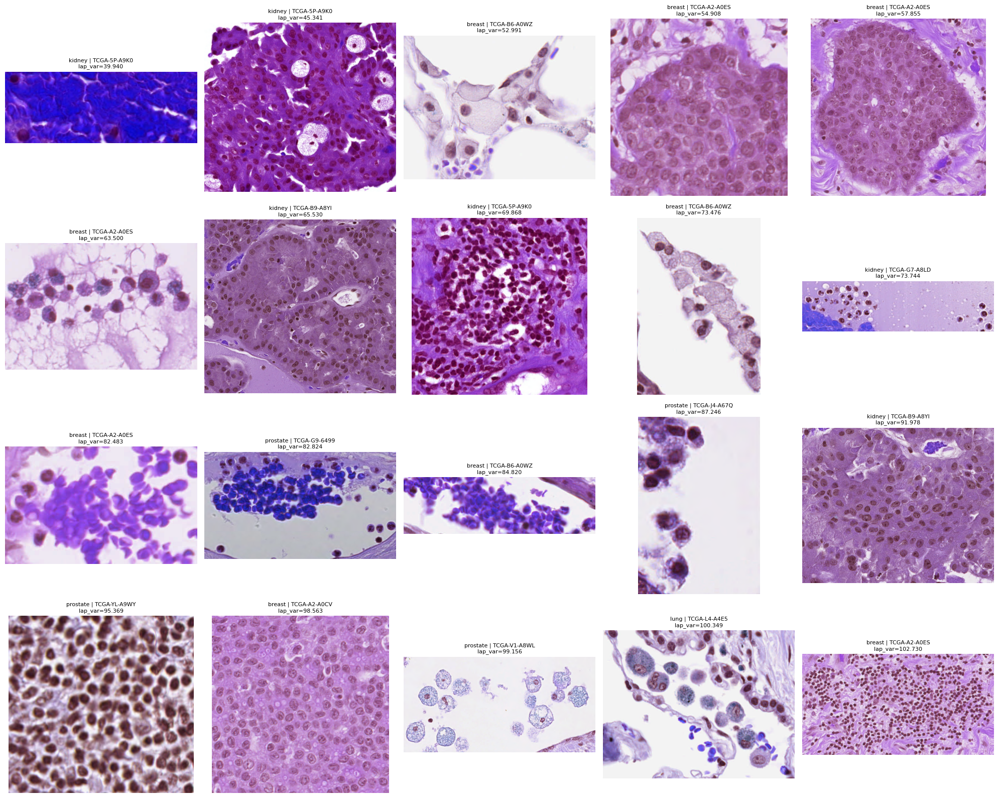

In [ ]:
show_worst_patches(df_quality, metric="lap_var", n_patches=20, ascending=True, path_col="path")

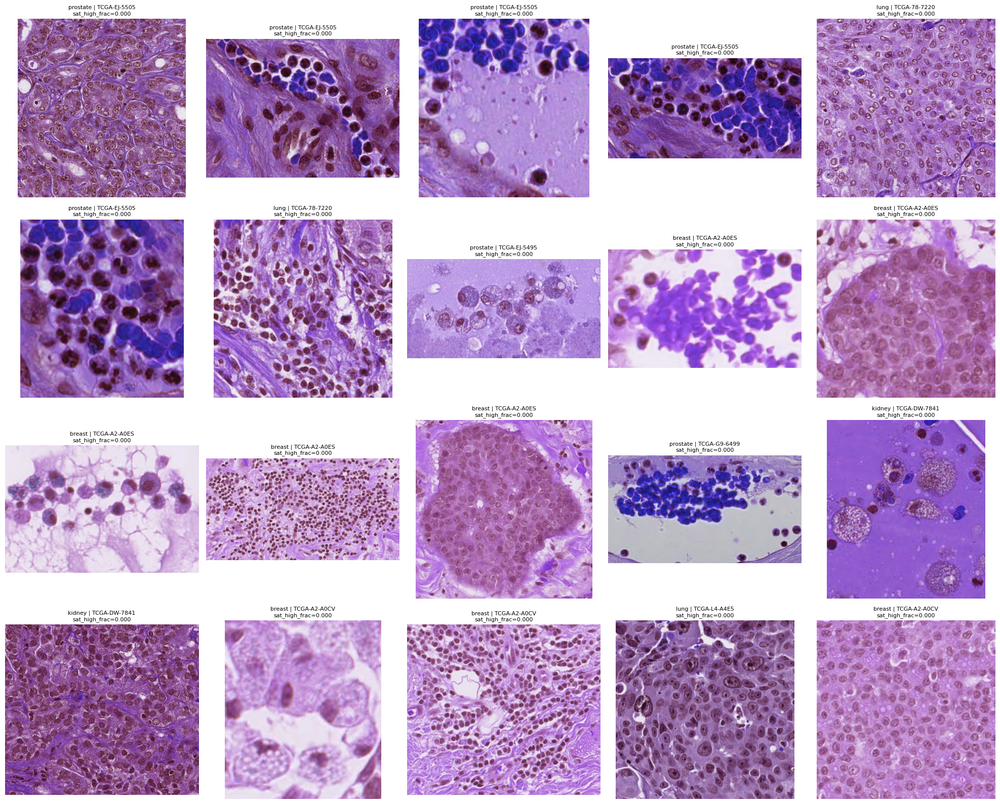

In [ ]:
show_worst_patches(df_quality, metric="sat_high_frac", n_patches=20, ascending=True, path_col="path")

In [ ]:
# Thresholds based on your boxplots
LAP_VAR_MIN  = 100    # very blured data
SAT_HIGH_MIN = 0.05   # >5% very bright pixels (>250)

df_quality["flag_blur"] = df_quality["lap_var"] < LAP_VAR_MIN
df_quality["flag_sat"]  = df_quality["sat_high_frac"] > SAT_HIGH_MIN

df_bad = df_quality[(df_quality["flag_blur"]) |
                    (df_quality["flag_sat"])]

print("Problematic patches:", len(df_bad))
df_bad[["path", "organ", "patient_id",
        "lap_var", "sat_high_frac"]].head()


Problematic patches: 18


,path,organ,patient_id,lap_var,sat_high_frac
11,/content/MoNuSAC_images_and_annotations/TCGA-B...,breast,TCGA-B6-A0WZ,73.476485,0.000484
14,/content/MoNuSAC_images_and_annotations/TCGA-B...,breast,TCGA-B6-A0WZ,52.990878,0.000334
16,/content/MoNuSAC_images_and_annotations/TCGA-B...,breast,TCGA-B6-A0WZ,84.819813,0.001001
50,/content/MoNuSAC_images_and_annotations/TCGA-5...,kidney,TCGA-5P-A9K0,45.340821,0.034632
51,/content/MoNuSAC_images_and_annotations/TCGA-5...,kidney,TCGA-5P-A9K0,39.940386,0.000011


We start building a data frame called df_bad with the samples we are not taking for the training.

## 5- Consistency between annotations and images

In [ ]:
def check_xml_presence(df, sample_size=50):
    """
    Checks for the existence of corresponding XML files for a sample of images.
    """
    col = "path"

    if sample_size is not None and len(df) > sample_size:
        df_sample = df.sample(sample_size, random_state=42)
    else:
        df_sample = df

    missing = []

    for _, row in df_sample.iterrows():
        img_path = row[col]
        xml_path = find_xml_for_image(img_path)
        if xml_path is None:
            missing.append(img_path)

    print(f"Images tested: {len(df_sample)}")
    print(f"Missing corresponding XML: {len(missing)}")
    if missing:
        print("Examples without XML:")
        for p in missing[:10]:
            print("  ", p)

def check_polygon_bounds_for_image(img_path, xml_path):
    """
    Returns (is_ok, num_out_of_bounds, total_points).
    Checks if all polygon coordinates are within the image dimensions.
    """
    img = Image.open(img_path)
    width, height = img.size

    nuclei = parse_monusac_xml(xml_path)
    total_pts = 0
    out_pts = 0

    for nuc in nuclei:
        for (x, y) in nuc["points"]:
            total_pts += 1
            # Check if point is outside image boundaries
            if not (0 <= x < width and 0 <= y < height):
                out_pts += 1

    is_ok = (out_pts == 0)
    return is_ok, out_pts, total_pts


def check_polygon_bounds(df, sample_size=50):
    """
    Verifies polygon boundaries for a sample of TIFF images.
    Returns a DataFrame df_poly_bad containing problematic images.
    """
    if sample_size is not None and len(df) > sample_size:
        df_sample = df.sample(sample_size, random_state=42)
    else:
        df_sample = df

    problems = []

    for _, row in df_sample.iterrows():
        img_path = row["path"]
        xml_path = find_xml_for_image(img_path)
        if xml_path is None:
            continue

        is_ok, out_pts, total = check_polygon_bounds_for_image(img_path, xml_path)
        if not is_ok:
            problems.append({
                "path": img_path,
                "xml_path": xml_path,
                "out_pts": out_pts,
                "total_pts": total,
            })

    df_poly_bad = pd.DataFrame(problems)

    print(f"Images tested: {len(df_sample)}")
    print(f"Images with out-of-bounds points: {len(df_poly_bad)}")

    # Display a few examples of problematic files
    for _, p in df_poly_bad.head(10).iterrows():
        print(f"  {p['path']} | out_of_bounds={p['out_pts']}/{p['total_pts']}")

    return df_poly_bad

In [ ]:
df_tif = df_images[df_images["ext"] == "tif"].copy()
sample_size, num_column = df_tif.shape

check_xml_presence(df_tif, sample_size)

Images tested: 209
Missing corresponding XML: 0


In [ ]:
sample_size = len(df_tif)
df_poly_bad = check_polygon_bounds(df_tif, sample_size)

Images tested: 209
Images with out-of-bounds points: 87
  /content/MoNuSAC_images_and_annotations/TCGA-D8-A1X5-01Z-00-DX2/TCGA-D8-A1X5-01Z-00-DX2_4.tif | out_of_bounds=16/1679
  /content/MoNuSAC_images_and_annotations/TCGA-D8-A1X5-01Z-00-DX2/TCGA-D8-A1X5-01Z-00-DX2_2.tif | out_of_bounds=20/31720
  /content/MoNuSAC_images_and_annotations/TCGA-D8-A1X5-01Z-00-DX2/TCGA-D8-A1X5-01Z-00-DX2_3.tif | out_of_bounds=166/39846
  /content/MoNuSAC_images_and_annotations/TCGA-P4-AAVK-01Z-00-DX1/TCGA-P4-AAVK-01Z-00-DX1_2.tif | out_of_bounds=6/5587
  /content/MoNuSAC_images_and_annotations/TCGA-B6-A0WZ-01Z-00-DX1/TCGA-B6-A0WZ-01Z-00-DX1_1.tif | out_of_bounds=14/32083
  /content/MoNuSAC_images_and_annotations/TCGA-B6-A0WZ-01Z-00-DX1/TCGA-B6-A0WZ-01Z-00-DX1_5.tif | out_of_bounds=1/14621
  /content/MoNuSAC_images_and_annotations/TCGA-V1-A9O9-01Z-00-DX1/TCGA-V1-A9O9-01Z-00-DX1-1.tif | out_of_bounds=27/17130
  /content/MoNuSAC_images_and_annotations/TCGA-V1-A9O9-01Z-00-DX1/TCGA-V1-A9O9-01Z-00-DX1-3.tif | ou

In [ ]:
paths_bad_quality = set(df_bad["path"])
paths_bad_poly = set(df_poly_bad["path"])

paths_to_remove = paths_bad_quality.union(paths_bad_poly)
df_to_remove = df_tif[df_tif["path"].isin(paths_to_remove)].copy()

print("Nb images à enlever :", len(df_to_remove))
df_to_remove[["path", "organ", "patient_id"]].head()

Nb images à enlever : 97


,path,organ,patient_id
0,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5
1,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5
2,/content/MoNuSAC_images_and_annotations/TCGA-D...,breast,TCGA-D8-A1X5
12,/content/MoNuSAC_images_and_annotations/TCGA-P...,kidney,TCGA-P4-AAVK
22,/content/MoNuSAC_images_and_annotations/TCGA-B...,breast,TCGA-B6-A0WZ


In [ ]:
df_clean = df_tif[~df_tif["path"].isin(paths_to_remove)].copy()

We obtained the final data frame with the data we want to keep, we now have to retrieve it to construct the data set.

## Saving the data


### Spliting 80% training and 20% validation
I choose to split the train and validation dataset using patient and organ splitting with 80% for the training and 20% for the validation.

In [ ]:
def train_val_split_by_patient(df, test_size=0.2, random_state=42,
                               patient_col="patient_id", organ_col="organ"):
    """
    Splits the dataset into training and validation sets while ensuring that
    all patches from the same patient stay within the same split.

    Returns: The DataFrame with an added 'split' column ∈ {'train', 'val'}.
    """
    assert patient_col in df.columns, f"{patient_col} missing from df"
    assert organ_col in df.columns, f"{organ_col} missing from df"

    df = df.copy()
    df["split"] = None

    # Group by organ to ensure balanced representation across splits
    for organ, df_org in df.groupby(organ_col):
        unique_patients = df_org[patient_col].unique()

        # Perform the split at the patient level
        train_patients, val_patients = train_test_split(
            unique_patients,
            test_size=test_size,
            random_state=random_state,
            shuffle=True,
        )
        mask_train = (df[organ_col] == organ) & (df[patient_col].isin(train_patients))
        mask_val   = (df[organ_col] == organ) & (df[patient_col].isin(val_patients))

        df.loc[mask_train, "split"] = "train"
        df.loc[mask_val,   "split"] = "val"

    return df

In [ ]:
df_split = train_val_split_by_patient(df_clean, test_size=0.2, random_state=42)

print(df_split["split"].value_counts())
print(df_split.groupby(["organ", "split"])["patient_id"].nunique())

split
train    87
val      25
Name: count, dtype: int64
organ     split
breast    train     7
          val       2
kidney    train     8
          val       2
lung      train     8
          val       2
prostate  train    10
          val       3
Name: patient_id, dtype: int64


### Structures preparation

In [ ]:
ROOT_PATCHES = Path("MoNuSAC_patches_0.25um_512")
for subset in ["train", "val"]:
    (ROOT_PATCHES / subset / "images").mkdir(parents=True, exist_ok=True)
    (ROOT_PATCHES / subset / "masks").mkdir(parents=True, exist_ok=True)

print("File created under:", ROOT_PATCHES.resolve())

File created under: /content/MoNuSAC_patches_0.25um_512


In [ ]:
meta_cols = ["path", "patient_id", "organ", "ext", "split"]
metadata = df_split[meta_cols].copy()

# rename patient_id -> patientid
metadata = metadata.rename(columns={"patient_id": "patientid"})

metadata_path = ROOT_PATCHES / "image_metadata.csv"
metadata.to_csv(metadata_path, index=False)
print("Data saved under:", metadata_path)

Data saved under: MoNuSAC_patches_0.25um_512/image_metadata.csv


### Patch generation

According to the previous data analysis, here are the shape choosen:

In [ ]:
TARGET_SPACING = 0.25  # µm / pixel
PATCH_SIZE = 512       # 512 x 512
ROOT_PATCHES = Path("MoNuSAC_patches_0.25um_512")

df_split = df_split.copy()

In [ ]:
def resample_to_target_spacing(img: Image.Image,
                               spacing_x_um: float,
                               spacing_y_um: float,
                               target_spacing_um: float = TARGET_SPACING) -> Image.Image:
    """
    img: PIL.Image RGB
    spacing_x_um, spacing_y_um: curent resolution (µm/pixel)
    target_spacing_um: wanted resolution (µm/pixel)
    """
    if spacing_x_um is None or spacing_y_um is None:
        return img

    scale_x = spacing_x_um / target_spacing_um
    scale_y = spacing_y_um / target_spacing_um

    new_w = int(round(img.width  * scale_x))
    new_h = int(round(img.height * scale_y))

    if new_w <= 0 or new_h <= 0:
        return img

    return img.resize((new_w, new_h), resample=Image.BILINEAR)

In [ ]:
def extract_patches_from_image(img: Image.Image,
                               base_name: str,
                               subset: str,
                               organ: str,
                               patientid: str,
                               save_masks: bool = False):
    """
    Extracts square patches from an image using a sliding window.

    img        : PIL.Image
    base_name  : Base name (without extension) of the source image
    subset     : 'train' or 'val'
    organ, patientid : Metadata for building readable filenames
    save_masks : Placeholder for future use when masks are available
    """
    img = img.convert("RGB")
    w, h = img.size

    # Define output directories
    out_img_dir = ROOT_PATCHES / subset / "images"
    out_mask_dir = ROOT_PATCHES / subset / "masks"

    patch_idx = 0

    # Sliding window extraction
    for y in range(0, h - PATCH_SIZE + 1, PATCH_SIZE):
        for x in range(0, w - PATCH_SIZE + 1, PATCH_SIZE):
            patch = img.crop((x, y, x + PATCH_SIZE, y + PATCH_SIZE))

            # Constructing a descriptive filename
            patch_name = f"{organ}_{patientid}_{base_name}_patch{patch_idx:04d}.png"
            patch_path = out_img_dir / patch_name

            patch.save(patch_path)
            patch_idx += 1



def make_patches_for_all_images(df):
    """
    Iterates through the dataframe to load, resample, and patch all images.
    """
    records = []

    for _, row in tqdm(df.iterrows(), total=len(df), desc="Extracting patches"):
        img_path = Path(row["path"])
        subset   = row["split"]    # 'train' or 'val'
        organ    = row["organ"]
        patientid = row["patient_id"]
        spacing_x = row.get("spacingxum", None)
        spacing_y = row.get("spacingyum", None)

        if subset not in ("train", "val"):
            continue

        # File existence safety check
        if not img_path.is_file():
            continue

        img = Image.open(img_path).convert("RGB")
        img_resampled = resample_to_target_spacing(img, spacing_x, spacing_y, TARGET_SPACING)

        # Base name: filename without extension
        base_name = img_path.stem

        # Extract and save patches
        extract_patches_from_image(
            img_resampled,
            base_name=base_name,
            subset=subset,
            organ=organ,
            patientid=patientid,
            save_masks=False
        )

In [ ]:
make_patches_for_all_images(df_split)

Extracting patches: 100%|██████████| 112/112 [00:11<00:00,  9.61it/s]


### XML generation

In [ ]:
def find_xml_for_image(img_path: Path):
    folder = img_path.parent
    base = img_path.stem  # ex: TCGA-55-1594-01Z-00-DX1-004
    cand = glob.glob(os.path.join(str(folder), base + ".xml"))
    return Path(cand[0]) if cand else None

In [ ]:
CELL_LABELS = {
    "epithelial": 1,
    "lymphocyte": 2,
    "macrophage": 3,
    "neutrophil": 4,
    "ambiguous": 5,
}

def rasterize_nuclei_to_mask(width, height, nuclei, cell_labels=CELL_LABELS):
    """
    width, height : Dimensions of the original image (before resampling)
    Returns a 2D numpy mask (H, W) of integers.
    """
    mask = Image.new("L", (width, height), 0)
    draw = ImageDraw.Draw(mask)

    for nuc in nuclei:
        pts = nuc["points"]
        celltype = nuc.get("type", "ambiguous")
        label = cell_labels.get(celltype, 0)

        if label == 0:
            continue

        draw.polygon(pts, outline=label, fill=label)

    return np.array(mask, dtype=np.uint8)

def compute_resample_size(width, height, spacing_x_um, spacing_y_um,
                          target_spacing_um=TARGET_SPACING):
    """
    Calculates the new dimensions based on micron-per-pixel spacing.
    """
    if spacing_x_um is None or spacing_y_um is None:
        return width, height, 1.0, 1.0

    scale_x = spacing_x_um / target_spacing_um
    scale_y = spacing_y_um / target_spacing_um

    new_w = int(round(width  * scale_x))
    new_h = int(round(height * scale_y))
    return new_w, new_h, scale_x, scale_y

def resample_image_and_mask(img: Image.Image,
                            mask_np: np.ndarray,
                            spacing_x_um: float,
                            spacing_y_um: float,
                            target_spacing_um: float = TARGET_SPACING):
    """
    Resamples both the image and the mask to match the target spacing.
    Uses Bilinear for images and Nearest Neighbor for masks to preserve labels.
    """
    w, h = img.size
    new_w, new_h, scale_x, scale_y = compute_resample_size(
        w, h, spacing_x_um, spacing_y_um, target_spacing_um
    )

    if new_w <= 0 or new_h <= 0:
        return img, mask_np

    # Resample image (Bilinear for smooth transitions)
    img_resampled = img.resize((new_w, new_h), resample=Image.BILINEAR)

    # Resample mask (Nearest to keep integer labels intact)
    mask_img = Image.fromarray(mask_np, mode="L")
    mask_resampled = mask_img.resize((new_w, new_h), resample=Image.NEAREST)
    mask_resampled_np = np.array(mask_resampled, dtype=np.uint8)

    return img_resampled, mask_resampled_np

def extract_patches_img_and_mask(img: Image.Image,
                                 mask_np: np.ndarray,
                                 base_name: str,
                                 subset: str,
                                 organ: str,
                                 patientid: str):
    """
    Extracts synchronized patches from both image and mask.
    """
    img = img.convert("RGB")
    w, h = img.size
    assert mask_np.shape == (h, w), "Mask and image must have the same size"

    out_img_dir  = ROOT_PATCHES / subset / "images"
    out_mask_dir = ROOT_PATCHES / subset / "masks"

    patch_idx = 0

    for y in range(0, h - PATCH_SIZE + 1, PATCH_SIZE):
        for x in range(0, w - PATCH_SIZE + 1, PATCH_SIZE):
            patch_img = img.crop((x, y, x + PATCH_SIZE, y + PATCH_SIZE))
            patch_mask = mask_np[y:y + PATCH_SIZE, x:x + PATCH_SIZE]

            if np.all(patch_mask == 0):
                continue

            patch_name = f"{organ}_{patientid}_{base_name}_patch{patch_idx:04d}.png"

            # Save image patch
            patch_img.save(out_img_dir / patch_name)

            # Save mask patch (as grayscale PNG)
            mask_img = Image.fromarray(patch_mask, mode="L")
            mask_img.save(out_mask_dir / patch_name)  # Matches image filename

            patch_idx += 1

def make_patches_with_masks(df):
    """
    Function to process the dataframe and generate annotated patches.
    """
    for _, row in tqdm(df.iterrows(), total=len(df), desc="Processing masks and patches"):
        img_path = Path(row["path"])
        subset   = row["split"]
        organ    = row["organ"]
        patientid = row["patient_id"]
        spacing_x = row.get("spacingxum", None)
        spacing_y = row.get("spacingyum", None)

        if subset not in ("train", "val"):
            continue
        if not img_path.is_file():
            continue

        # Find associated XML file
        xml_path = find_xml_for_image(img_path)
        if xml_path is None or not xml_path.is_file():
            continue  # Ignore image if no annotations are found

        # Parse nuclei polygons
        nuclei = parse_monusac_xml(str(xml_path))

        # Load image and create pixel-level mask
        img = Image.open(img_path).convert("RGB")
        w, h = img.size
        mask_np = rasterize_nuclei_to_mask(w, h, nuclei)

        # Resample both image and mask to target spacing
        img_resampled, mask_resampled = resample_image_and_mask(
            img, mask_np, spacing_x, spacing_y, TARGET_SPACING
        )
        base_name = img_path.stem

        # Extract and save synchronized patches
        extract_patches_img_and_mask(
            img_resampled,
            mask_resampled,
            base_name=base_name,
            subset=subset,
            organ=organ,
            patientid=patientid,
        )

In [ ]:
make_patches_with_masks(df_split)

Processing masks and patches:   0%|          | 0/112 [00:00<?, ?it/s]/tmp/ipython-input-2963407271.py:65: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  mask_img = Image.fromarray(mask_np, mode="L")
/tmp/ipython-input-2963407271.py:103: DeprecationWarning: 'mode' parameter is deprecated and will be removed in Pillow 13 (2026-10-15)
  mask_img = Image.fromarray(patch_mask, mode="L")
Processing masks and patches: 100%|██████████| 112/112 [00:15<00:00,  7.01it/s]


### Mask verification

In [ ]:
mask_path = Path("MoNuSAC_patches_0.25um_512/train/masks").glob("*.png")
mask_path = next(mask_path)

mask = np.array(Image.open(mask_path))
print("shape:", mask.shape)
print("unique values:", np.unique(mask))
print("min:", mask.min(), "max:", mask.max())

shape: (512, 512)
unique values: [0 2 3]
min: 0 max: 3


Even though the mask seems all black we can see differents values inside.

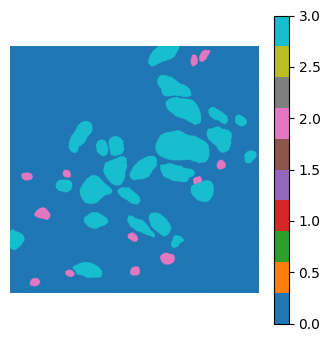

In [ ]:
plt.figure(figsize=(4,4))
plt.imshow(mask, cmap="tab10")
plt.colorbar()
plt.axis("off")
plt.show()

Image: /content/MoNuSAC_images_and_annotations/TCGA-D8-A1X5-01Z-00-DX2/TCGA-D8-A1X5-01Z-00-DX2_1.tif
XML: /content/MoNuSAC_images_and_annotations/TCGA-D8-A1X5-01Z-00-DX2/TCGA-D8-A1X5-01Z-00-DX2_1.xml
mask unique: [0 2 4]


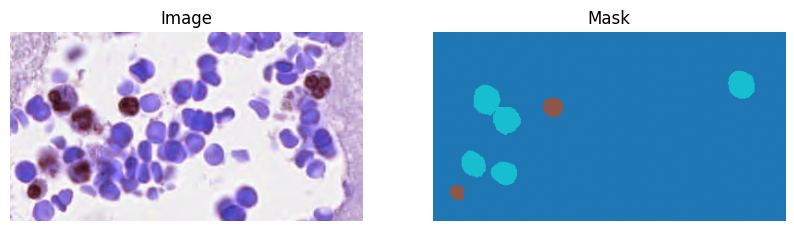

In [ ]:
row = df_split.iloc[0]
img_path = Path(row["path"])
xml_path = find_xml_for_image(img_path)

print("Image:", img_path)
print("XML:", xml_path)

img = Image.open(img_path).convert("RGB")
w, h = img.size

nuclei = parse_monusac_xml(str(xml_path))
mask_np = rasterize_nuclei_to_mask(w, h, nuclei)

print("mask unique:", np.unique(mask_np))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.imshow(img)
plt.axis("off")
plt.title("Image")

plt.subplot(1,2,2)
plt.imshow(mask_np, cmap="tab10")
plt.axis("off")
plt.title("Mask")
plt.show()


We confirmed that the masks are generated correctly.

### Zip the dataset

I choose to zip the training dataset created so I can work on another python notebook for the model definition and training.

In [ ]:
ROOT_PATCHES = Path("MoNuSAC_patches_0.25um_512")

zip_output = shutil.make_archive(
    base_name="MoNuSAC_patches_0.25um_512",
    format="zip",
    root_dir=str(ROOT_PATCHES.parent),
    base_dir=str(ROOT_PATCHES.name),
)

print("Zip created :", zip_output)

Zip created : /content/MoNuSAC_patches_0.25um_512.zip


In [ ]:
src = Path("MoNuSAC_patches_0.25um_512.zip")
dst = Path("/content/drive/MyDrive/data_CV/MoNuSAC_patches_0.25um_512.zip")

shutil.copy(src, dst)
print("Copied to :", dst)

Copied to : /content/drive/MyDrive/data_CV/MoNuSAC_patches_0.25um_512.zip
